In [2]:
# lets import data from pycaret itself
from pycaret.datasets import get_data
diabetes = get_data('diabetes')

,Number of times pregnant,Plasma glucose concentration a 2 hours in an oral glucose tolerance test,Diastolic blood pressure (mm Hg),Triceps skin fold thickness (mm),2-Hour serum insulin (mu U/ml),Body mass index (weight in kg/(height in m)^2),Diabetes pedigree function,Age (years),Class variable
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [3]:
# setting up the environment in pycaret
# our target variable here is 'Class variable'
from pycaret.classification import *
exp1 = setup(diabetes, target='Class variable')
# the setup() command takes care of all the preprocessing that the dataset need including all the train_test_split, the label encoders, etc based on the data it observes;
# ALL THE ABOVE STEPS ARE APPLIED AUTOMATICALLY WHEN setup() is INITIALIZED


Setup Succesfully Completed!


,Description,Value
0,session_id,4873
1,Target Type,Binary
2,Label Encoded,None
3,Original Data,"(768, 9)"
4,Missing Values,False
5,Numeric Features,7
6,Categorical Features,1
7,Ordinal Features,False
8,High Cardinality Features,False
9,High Cardinality Method,None


In [4]:
# COMPARE THE MODELS
# its the first step that is recommended in supervised learning exp (classification or regression)
# it trains all the models and compare them using the evaluation metrices containing, 
# for classification : Accuracy, AUC, Precision, Recall, F1, Kappa
# for regression: MAE, MSE, RMSE, R2, RMSLE, MAPE
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,Gradient Boosting Classifier,0.780300,0.835300,0.630100,0.710000,0.664800,0.502600
1,Extreme Gradient Boosting,0.772700,0.836100,0.629500,0.686600,0.654800,0.486300
2,CatBoost Classifier,0.765400,0.820300,0.604100,0.684200,0.636200,0.465600
3,Light Gradient Boosting Machine,0.757800,0.809400,0.619000,0.656400,0.631900,0.453400
4,Ridge Classifier,0.754300,0.000000,0.512900,0.707200,0.588200,0.421100
5,Logistic Regression,0.752400,0.810000,0.507300,0.704900,0.584200,0.416000
6,Linear Discriminant Analysis,0.750600,0.812400,0.512900,0.696300,0.584100,0.413600
7,Ada Boost Classifier,0.750400,0.799600,0.592400,0.656300,0.615600,0.433300
8,Random Forest Classifier,0.739400,0.778800,0.481300,0.681500,0.560300,0.383800
9,Extra Trees Classifier,0.735500,0.778200,0.495900,0.670900,0.558200,0.378500


In [5]:
# now lets create a mode, the function only takes one parameter as input
adaboost = create_model('ada')
# the variable stores trained model, the function is scikit-learn estimator 
# refer : https://pycaret.org/create-model/ for more models and estimators

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.7963,0.8180,0.5789,0.7857,0.6667,0.5248
1,0.7222,0.8466,0.5789,0.6111,0.5946,0.3836
2,0.7778,0.7609,0.5789,0.7333,0.6471,0.4882
3,0.7593,0.8248,0.6316,0.6667,0.6486,0.4658
4,0.6667,0.6947,0.4211,0.5333,0.4706,0.2322
5,0.7778,0.8301,0.7368,0.6667,0.7000,0.5242
6,0.7963,0.8496,0.8421,0.6667,0.7442,0.5787
7,0.6981,0.7810,0.3889,0.5833,0.4667,0.2677
8,0.7736,0.8317,0.7222,0.6500,0.6842,0.5085
9,0.7358,0.7587,0.4444,0.6667,0.5333,0.3592


In [6]:
adaboost.base_estimator_

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=1, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [7]:
adaboost.feature_importances_

array([0.2 , 0.06, 0.04, 0.1 , 0.16, 0.2 , 0.12, 0.02, 0.02, 0.  , 0.  ,
       0.  , 0.  , 0.02, 0.  , 0.  , 0.  , 0.02, 0.  , 0.  , 0.  , 0.  ,
       0.02, 0.02])

In [8]:
gradient = create_model('gbc') # example of implementing other model

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8519,0.9098,0.6842,0.8667,0.7647,0.6588
1,0.7778,0.8376,0.6316,0.7059,0.6667,0.5008
2,0.8148,0.8992,0.6842,0.7647,0.7222,0.5840
3,0.7778,0.8406,0.6316,0.7059,0.6667,0.5008
4,0.7037,0.7023,0.5789,0.5789,0.5789,0.3504
5,0.7593,0.8466,0.6316,0.6667,0.6486,0.4658
6,0.7778,0.8361,0.7368,0.6667,0.7000,0.5242
7,0.7736,0.8000,0.5000,0.7500,0.6000,0.4508
8,0.8679,0.8556,0.7778,0.8235,0.8000,0.7015
9,0.6981,0.8254,0.4444,0.5714,0.5000,0.2886


In [9]:
# now we will focus on the adaboost model
tuned_adaboost = tune_model('ada')
# after tuning the accuracy has increased

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8333,0.8744,0.6316,0.8571,0.7273,0.6112
1,0.7593,0.8481,0.5789,0.6875,0.6286,0.4524
2,0.8704,0.8902,0.7368,0.8750,0.8000,0.7051
3,0.7778,0.8481,0.5263,0.7692,0.6250,0.4749
4,0.7037,0.7271,0.3684,0.6364,0.4667,0.2812
5,0.7222,0.8233,0.5263,0.6250,0.5714,0.3682
6,0.7037,0.8038,0.5263,0.5882,0.5556,0.3344
7,0.7358,0.8024,0.3889,0.7000,0.5000,0.3399
8,0.8868,0.8603,0.8333,0.8333,0.8333,0.7476
9,0.7170,0.8127,0.4444,0.6154,0.5161,0.3234


In [10]:
## ENSEMBLING
# creating an Model
dt = create_model('dt')

# ensemble the trained model
dt_bagged = ensemble_model(dt)
# 'bagging' method is used for ensembling by default, it can be changed to 'boosting' by using method parameter

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8333,0.8632,0.6842,0.8125,0.7429,0.6209
1,0.7593,0.8331,0.4737,0.7500,0.5806,0.4236
2,0.8148,0.8406,0.5789,0.8462,0.6875,0.5624
3,0.6852,0.7564,0.3684,0.5833,0.4516,0.2463
4,0.7037,0.6346,0.4211,0.6154,0.5000,0.2998
5,0.7593,0.7744,0.6316,0.6667,0.6486,0.4658
6,0.6852,0.7368,0.4211,0.5714,0.4848,0.2656
7,0.7358,0.7857,0.4444,0.6667,0.5333,0.3592
8,0.7925,0.8714,0.6667,0.7059,0.6857,0.5310
9,0.7547,0.7373,0.5000,0.6923,0.5806,0.4136


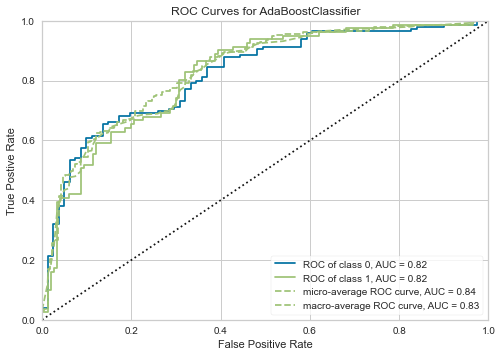

In [11]:
## PLOTTING THE MODEL
# refer https://pycaret.org/plot-model/ for other plots
# AUC plot - area under the curve
plot_model(adaboost, plot="auc")

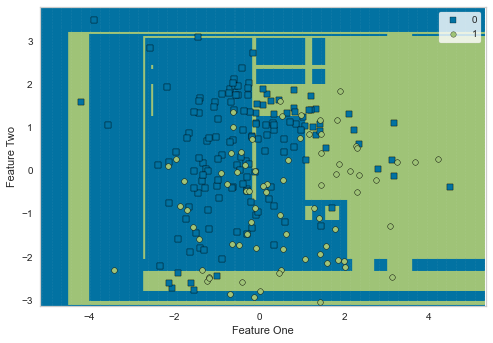

In [12]:
# Decision Boundary - is the region  of the hyperspace where output label of a classifier is ambiguos
plot_model(adaboost, plot="boundary")

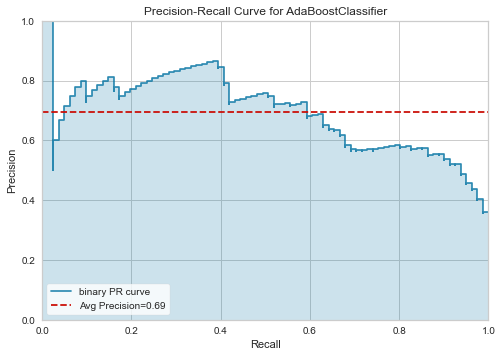

In [13]:
# Precision Recall Curve
plot_model(adaboost, plot="pr")

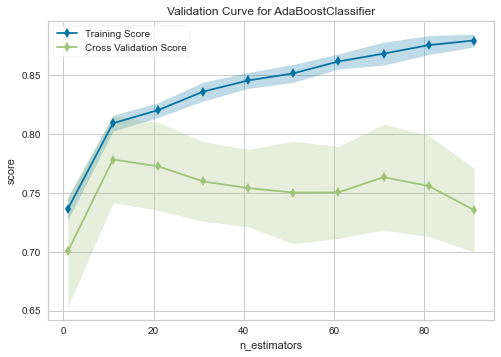

In [14]:
# Validation Curve
plot_model(adaboost, plot="vc")

In [16]:
# evaluating the model -> this will provide all the plots 
evaluate_model(adaboost)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,0.8148,0.9143,0.6842,0.7647,0.7222,0.5840
1,0.7778,0.8421,0.7368,0.6667,0.7000,0.5242
2,0.8889,0.9248,0.8421,0.8421,0.8421,0.7564
3,0.7222,0.8195,0.5789,0.6111,0.5946,0.3836
4,0.7407,0.7534,0.5263,0.6667,0.5882,0.4028
5,0.7778,0.8436,0.6842,0.6842,0.6842,0.5128
6,0.7593,0.8301,0.6316,0.6667,0.6486,0.4658
7,0.7358,0.7651,0.5000,0.6429,0.5625,0.3775
8,0.8113,0.8540,0.6667,0.7500,0.7059,0.5677
9,0.6981,0.8143,0.4444,0.5714,0.5000,0.2886


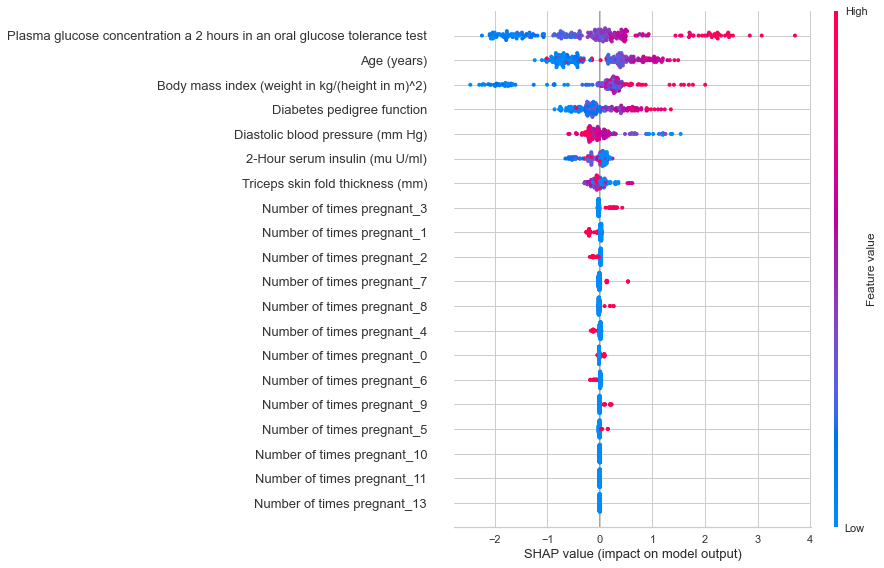

In [17]:
## INTERPRETING the MODELS

# create a model
xgboost = create_model('xgboost')

# summary plot
interpret_model(xgboost)

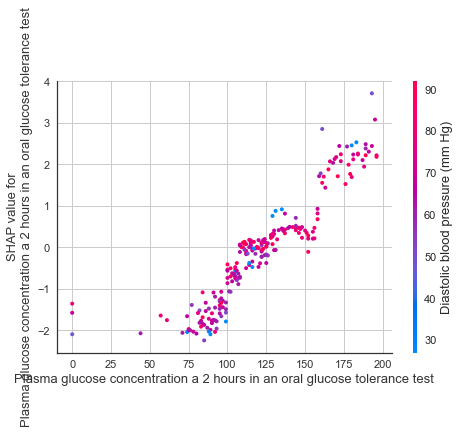

In [18]:
# correlation plot
interpret_model(xgboost, plot = "correlation")

In [19]:
interpret_model(xgboost, plot='reason', observation=0)

In [20]:
## PREDICTION MODEL

# create a model
rf = create_model('rf')

# predict test
rf_holdout_prediction = predict_model(rf)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa
0,Random Forest Classifier,0.71,0.784,0.5309,0.5972,0.5621,0.3464


In [22]:
predictions = predict_model(rf, data=diabetes)

In [24]:
# saving the model
save_model(adaboost, model_name = 'ada_for_dev') # it will be saved as pickle file (.pkl)
# pickling is a way to convert pytohn object into  a character stream

Transformation Pipeline and Model Succesfully Saved
